<a href="https://colab.research.google.com/github/freefrit/project-metric_learning/blob/main/LiftedStructureLoss_re.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Install the necessary packages

In [1]:
!pip install -q pytorch-metric-learning[with-hooks]
!pip install umap-learn

## Import the packages

In [2]:
# Packages for pytorch metric learning
%matplotlib inline
from pytorch_metric_learning import losses, miners, samplers, trainers, testers
from pytorch_metric_learning.utils import common_functions
import pytorch_metric_learning.utils.logging_presets as logging_presets
from pytorch_metric_learning.utils.accuracy_calculator import AccuracyCalculator
import numpy as np
import torchvision
from torchvision import datasets, transforms
import torch
import torch.nn as nn
from PIL import Image
import logging
import matplotlib.pyplot as plt
import umap
from cycler import cycler
import record_keeper
import pytorch_metric_learning
logging.getLogger().setLevel(logging.INFO)
logging.info("VERSION %s"%pytorch_metric_learning.__version__)

# Packages for preparing dataset
import json
from torch.utils.data import Dataset, DataLoader

# Packages for lmporting data from google drive
from google.colab import drive
import os
drive.mount('/content/gdrive')
root = '/content/gdrive/My Drive/Stanford_Online_Products'

INFO:root:VERSION 0.9.99


Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [3]:
# !rm -rf example_logs/ example_saved_models/ example_tensorboard/
# !cp /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss/example_logs_20b.zip /content
# !cp /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss/example_saved_models_20b.zip /content
# !cp /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss/example_tensorboard_20b.zip /content

In [4]:
# !unzip /content/example_logs_20b.zip
# !unzip /content/example_saved_models_20b.zip
# !unzip /content/example_tensorboard_20b.zip

## Simple model def

In [5]:
class MLP(nn.Module):
    # layer_sizes[0] is the dimension of the input
    # layer_sizes[-1] is the dimension of the output
    def __init__(self, layer_sizes, final_relu=False):
        super().__init__()
        layer_list = []
        layer_sizes = [int(x) for x in layer_sizes]
        num_layers = len(layer_sizes) - 1
        final_relu_layer = num_layers if final_relu else num_layers - 1
        for i in range(len(layer_sizes) - 1):
            input_size = layer_sizes[i]
            curr_size = layer_sizes[i + 1]
            if i < final_relu_layer:
                layer_list.append(nn.ReLU(inplace=False))
            layer_list.append(nn.Linear(input_size, curr_size))
        self.net = nn.Sequential(*layer_list)
        self.last_linear = self.net[-1]

    def forward(self, x):
        return self.net(x)

## Initialize models, optimizers and image transforms

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Set trunk model and replace the softmax layer with an identity function
trunk = torchvision.models.resnet50(pretrained=True)
trunk_output_size = trunk.fc.in_features
trunk.fc = common_functions.Identity()
trunk = torch.nn.DataParallel(trunk.to(device))

# Set embedder model. This takes in the output of the trunk and outputs 32 dimensional embeddings
embedder = torch.nn.DataParallel(MLP([trunk_output_size, 32]).to(device))

# Set optimizers
trunk_optimizer = torch.optim.Adam(trunk.parameters(), lr=0.00001, weight_decay=0.0001)
embedder_optimizer = torch.optim.Adam(embedder.parameters(), lr=0.0001, weight_decay=0.0001)

# Set the image transforms
train_transform = transforms.Compose([transforms.Resize(32),
                                      transforms.RandomResizedCrop(scale=(0.16, 1), ratio=(0.75, 1.33), size=32),
                                      transforms.RandomHorizontalFlip(0.5),                    
                                      transforms.ToTensor(),
                                      transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
                                      ])
# train_transform = transforms.Compose([transforms.Resize(32),
#                                     transforms.RandomResizedCrop(scale=(0.16, 1), ratio=(0.75, 1.33), size=32),
#                                     transforms.RandomHorizontalFlip(0.5),
#                                     transforms.ToTensor(),
#                                     transforms.Normalize([0.5], [0.5])])
# origin: transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

val_transform = transforms.Compose([transforms.Resize(32),
                                    transforms.CenterCrop(32),
                                    transforms.ToTensor(),
                                    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
                                    ])


## Create the dataset

In [7]:
class OnlineProducts_datasets_in_CIFAR(Dataset):
  def __init__(self, root, train = True, transform = None):
    """
    Dataset Init-Function.
    Args:
        root: the root of the dataset.
        train: declear that the dataset is training or testing.
        transform: the image transform mode you have to set before.
    Returns:
        Nothing!
    """
    super(OnlineProducts_datasets_in_CIFAR, self).__init__()
    self.train = train
    self.transform = transform

    # if training, load the training annotation file, else load the testing one.
    # the .json file stores the info of annotation in dict shape: 
    #   {'image': filenames, 'label': annotations} where filenames and annotations are arrays.
    if self.train:
      file_annotation = root + '/annotations/OnlineProducts_train_new.json'
    else:
      file_annotation = root + '/annotations/OnlineProducts_test_new.json'
    self.img_folder = root + '/images/'

    # read the file and check if the length of filenames and annotations are same.
    fp = open(file_annotation,'r')
    data_dict = json.load(fp)
    assert len(data_dict['image']) == len(data_dict['label'])
    num_data = len(data_dict['image'])
    fp.close()

    # put the filenames into self.datanames, their annotations into self.targets.
    self.datanames = []
    self.targets = []
    for i in range(num_data):
      self.datanames.append(data_dict['image'][i])
      self.targets.append(data_dict['label'][i])

  def __getitem__(self, index):
    """
    Dataset Getitem-Function.
    Returns:
        img: the data image.
        target: the label num of the data. 
    """
    img_path = self.img_folder + self.datanames[index]
    target = self.targets[index]
    # img = plt.imread(img_path)
    img = Image.open(img_path)
    img = img.convert("RGB")
    
    if self.transform is not None:
      img = self.transform(img)
    # img = img.reshape((3, 32, 32))
    
    # target = np.argmax(target, axis = 0)

    return img, target

  def __len__(self):
        return len(self.datanames)

In [8]:
my_root = '/content/gdrive/My Drive/Stanford_Online_Products'

# Create the original datasets
train_dataset = OnlineProducts_datasets_in_CIFAR(root = my_root, train = True, transform = train_transform)
val_dataset = OnlineProducts_datasets_in_CIFAR(root = my_root, train = False, transform = val_transform)
                                                
# assert set(train_dataset.targets).isdisjoint(set(val_dataset.targets))                                                _transform)

## Create the loss, miner, sampler, and package them into dictionaries

In [9]:
# Set the loss function
loss = losses.LiftedStructureLoss(neg_margin=1, pos_margin=0)

# Set the mining function
miner = miners.MultiSimilarityMiner(epsilon=0.1)

# Set the dataloader sampler
sampler = samplers.MPerClassSampler(train_dataset.targets, m=4, length_before_new_iter=len(train_dataset))

# Set other training parameters
batch_size = 32
num_epochs = 40

# Package the above stuff into dictionaries.
models = {"trunk": trunk, "embedder": embedder}
optimizers = {"trunk_optimizer": trunk_optimizer, "embedder_optimizer": embedder_optimizer}
loss_funcs = {"metric_loss": loss}
mining_funcs = {"tuple_miner": miner}

In [10]:
# Remove logs if you want to train with new parameters
!rm -rf example_logs/ example_saved_models/ example_tensorboard/

## Create the training and testing hooks

In [11]:
record_keeper, _, _ = logging_presets.get_record_keeper("example_logs", "example_tensorboard")
hooks = logging_presets.get_hook_container(record_keeper)
dataset_dict = {"val": val_dataset}
model_folder = "example_saved_models"

def visualizer_hook(umapper, umap_embeddings, labels, split_name, keyname, *args):
    logging.info("UMAP plot for the {} split and label set {}".format(split_name, keyname))
    label_set = np.unique(labels)
    num_classes = len(label_set)
    fig = plt.figure(figsize=(20,15))
    plt.gca().set_prop_cycle(cycler("color", [plt.cm.nipy_spectral(i) for i in np.linspace(0, 0.9, num_classes)]))
    for i in range(num_classes):
        idx = labels == label_set[i]
        plt.plot(umap_embeddings[idx, 0], umap_embeddings[idx, 1], ".", markersize=1)   
    plt.show()

# Create the tester
tester = testers.GlobalEmbeddingSpaceTester(end_of_testing_hook = hooks.end_of_testing_hook, 
                                            visualizer = umap.UMAP(), 
                                            visualizer_hook = visualizer_hook,
                                            dataloader_num_workers = 32,
                                            accuracy_calculator=AccuracyCalculator(k=600))

end_of_epoch_hook = hooks.end_of_epoch_hook(tester, 
                                            dataset_dict, 
                                            model_folder, 
                                            test_interval = 1,
                                            # patience = 1
                                            )

## Create the trainer

In [12]:
trainer = trainers.MetricLossOnly(models,
                                optimizers,
                                batch_size,
                                loss_funcs,
                                mining_funcs,
                                train_dataset,
                                sampler=sampler,
                                dataloader_num_workers = 32,
                                end_of_iteration_hook = hooks.end_of_iteration_hook,
                                end_of_epoch_hook = end_of_epoch_hook)

## Start Tensorboard
(Turn off adblock and other shields)

In [13]:
%load_ext tensorboard
%tensorboard --logdir example_tensorboard

Reusing TensorBoard on port 6006 (pid 328), started 0:05:01 ago. (Use '!kill 328' to kill it.)

<IPython.core.display.Javascript object>

## Train the model

In [14]:
num_epochs

40

INFO:PML:Initializing dataloader
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
INFO:PML:Initializing dataloader iterator
INFO:PML:Done creating dataloader iterator
INFO:PML:TRAINING EPOCH 1
total_loss=11.17969: 100%|██████████| 1860/1860 [12:18<00:00,  2.52it/s]
INFO:PML:Evaluating epoch 1
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [18:13<00:00,  1.73it/s]
INFO:PML:Running UMAP on the val set
INFO:PML:Finished UMAP
INFO:root:UMAP plot for the val split and label set UMAP_level0


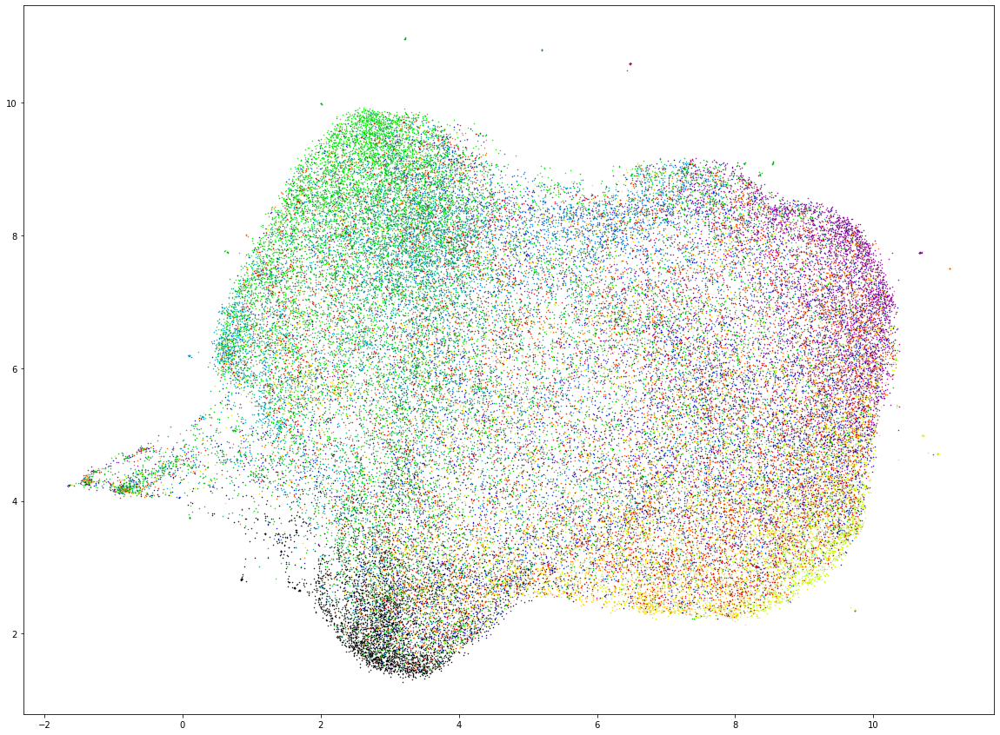

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.1196304962234523
INFO:PML:TRAINING EPOCH 2
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=11.60675: 100%|██████████| 1860/1860 [08:48<00:00,  3.52it/s]
INFO:PML:Evaluating epoch 2
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:30<00:00,  7.00it/s]
INFO:PML:Run

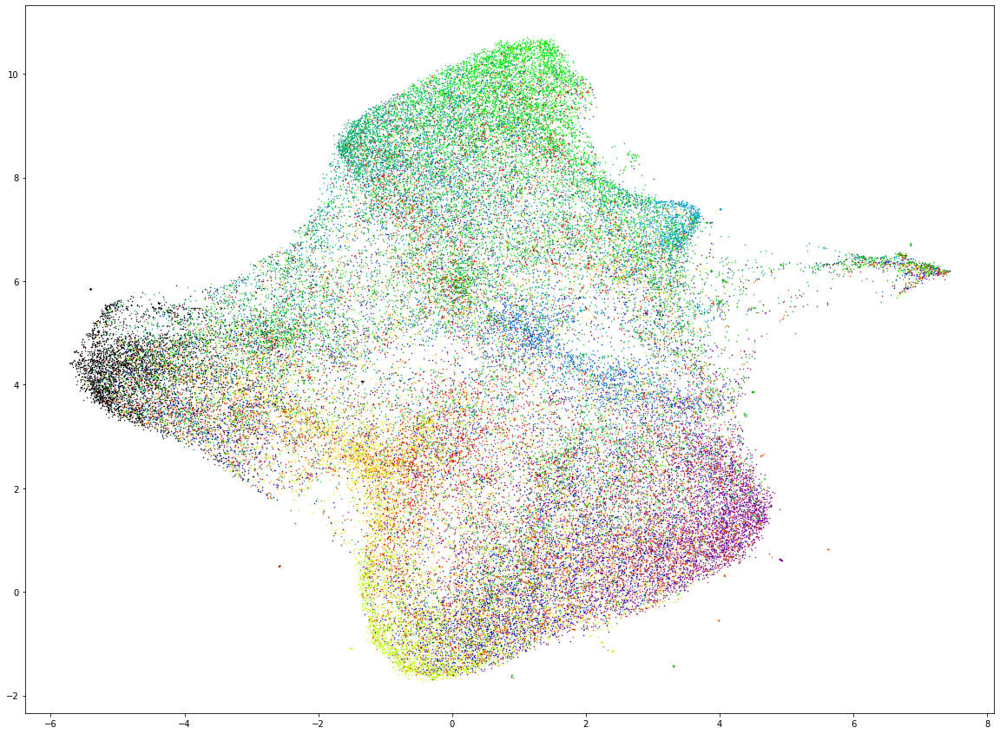

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.1736520837949691
INFO:PML:TRAINING EPOCH 3
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.71615: 100%|██████████| 1860/1860 [08:44<00:00,  3.55it/s]
INFO:PML:Evaluating epoch 3
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:35<00:00,  6.87it/s]
INFO:PML:Runn

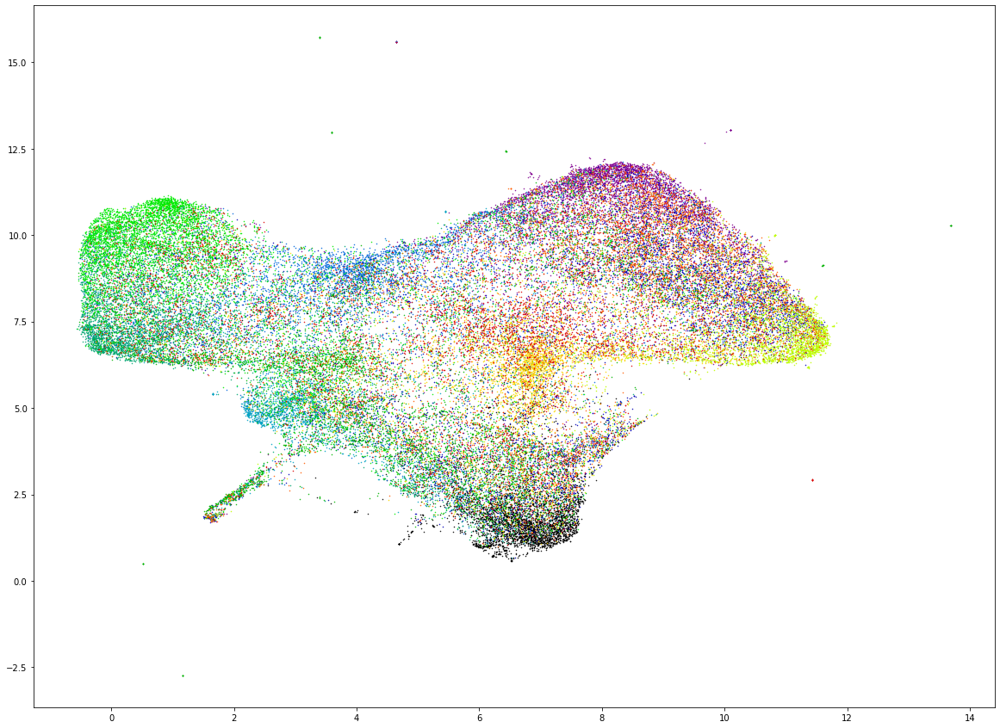

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.21486521615940446
INFO:PML:TRAINING EPOCH 4
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.58467: 100%|██████████| 1860/1860 [08:46<00:00,  3.53it/s]
INFO:PML:Evaluating epoch 4
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:42<00:00,  6.69it/s]
INFO:PML:Run

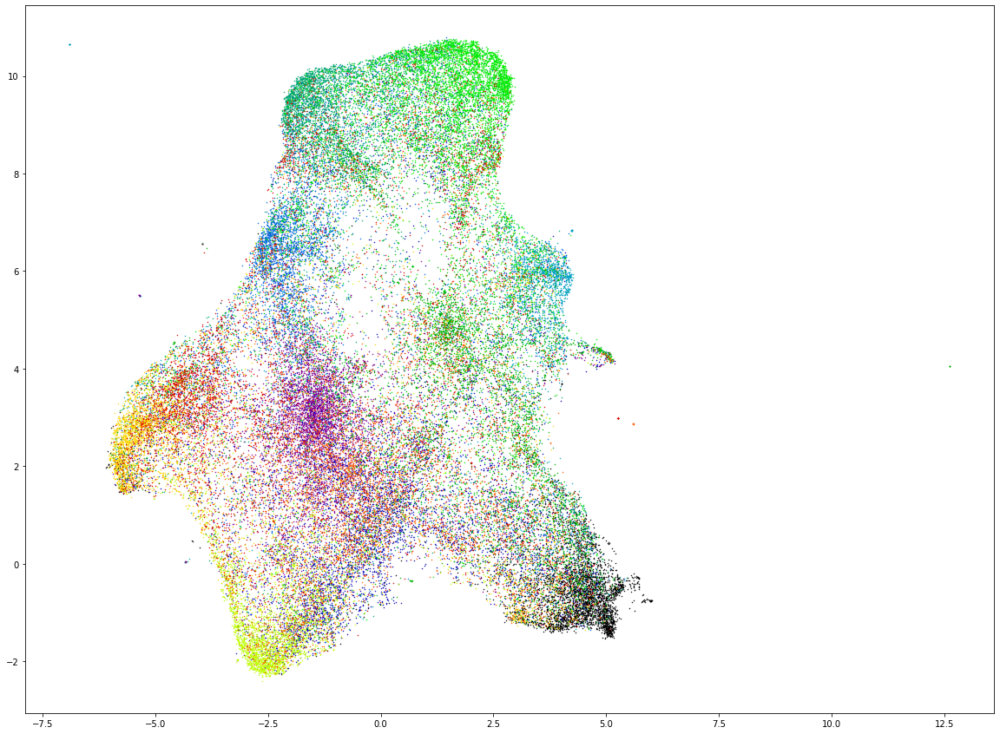

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.24724984265676753
INFO:PML:TRAINING EPOCH 5
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=10.76056: 100%|██████████| 1860/1860 [09:01<00:00,  3.43it/s]
INFO:PML:Evaluating epoch 5
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:50<00:00,  6.51it/s]
INFO:PML:Ru

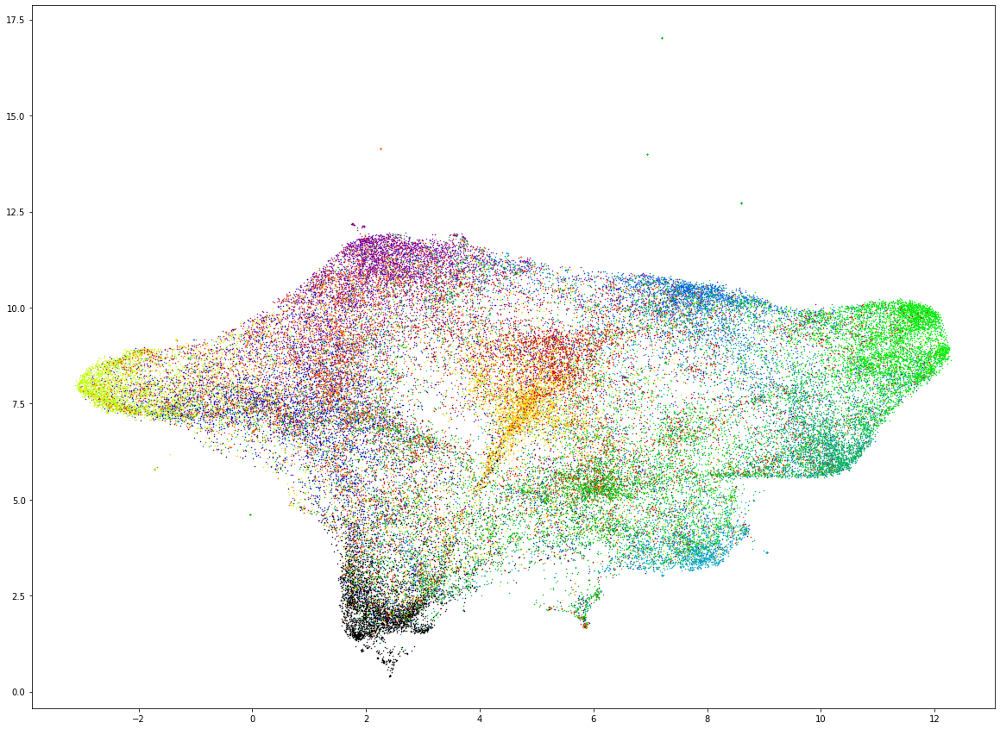

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.2698756457016988
INFO:PML:TRAINING EPOCH 6
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=10.06216: 100%|██████████| 1860/1860 [09:06<00:00,  3.40it/s]
INFO:PML:Evaluating epoch 6
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:56<00:00,  6.38it/s]
INFO:PML:Run

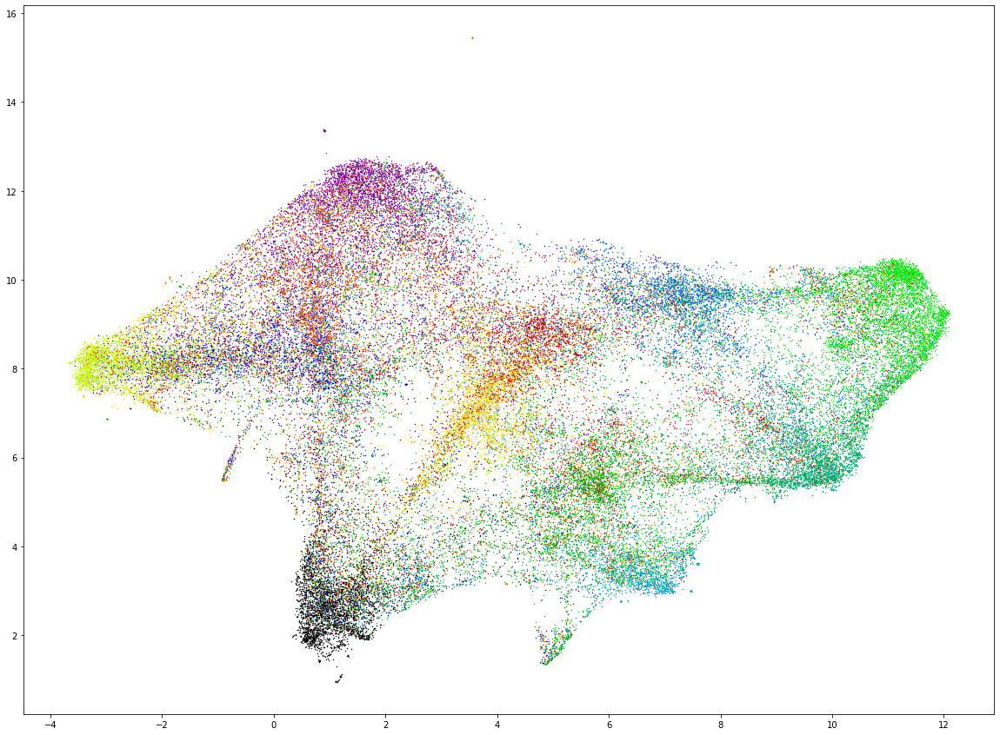

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.28889723074204626
INFO:PML:TRAINING EPOCH 7
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.07222: 100%|██████████| 1860/1860 [09:13<00:00,  3.36it/s]
INFO:PML:Evaluating epoch 7
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:57<00:00,  6.35it/s]
INFO:PML:Run

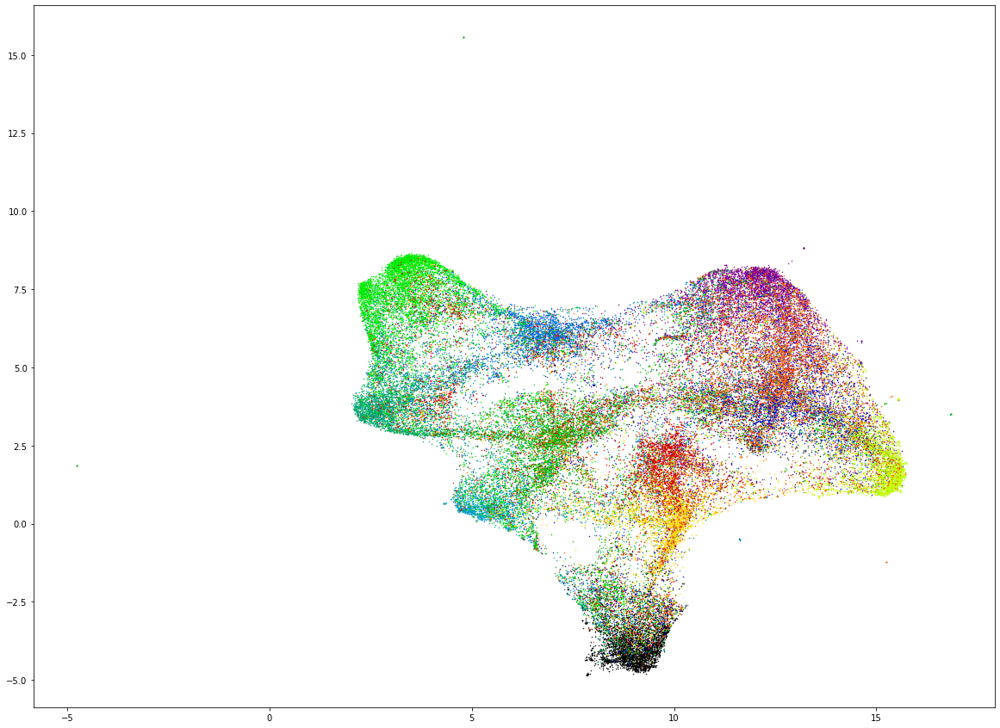

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3069047612533903
INFO:PML:TRAINING EPOCH 8
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.89605: 100%|██████████| 1860/1860 [09:12<00:00,  3.37it/s]
INFO:PML:Evaluating epoch 8
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [05:00<00:00,  6.29it/s]
INFO:PML:Runn

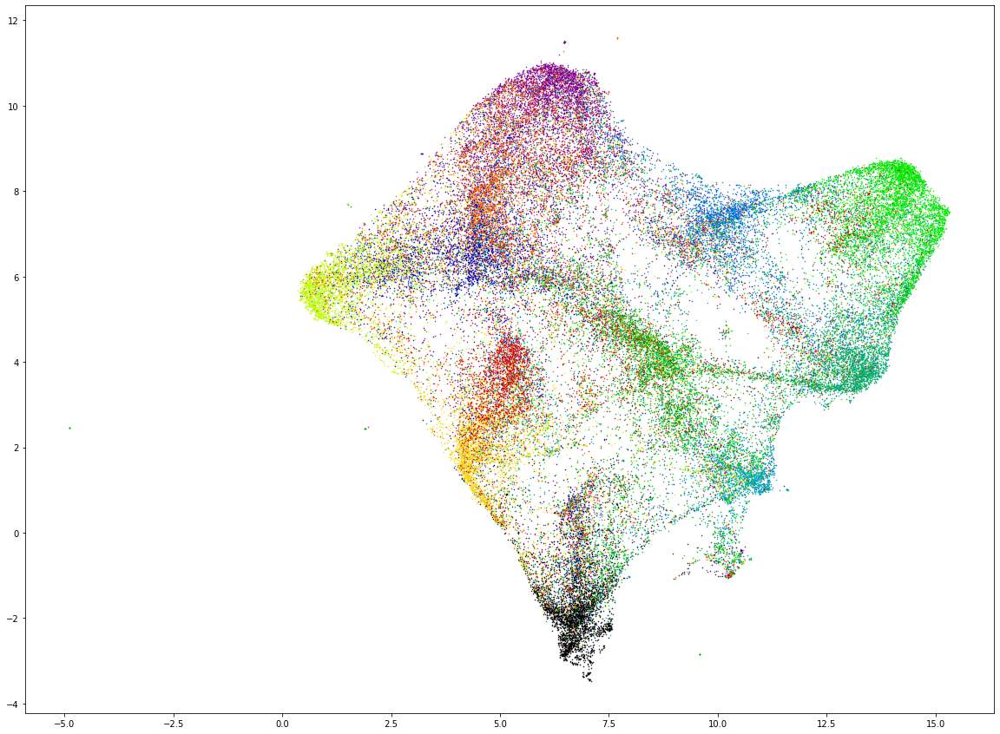

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.31635094440844136
INFO:PML:TRAINING EPOCH 9
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=11.50754: 100%|██████████| 1860/1860 [09:14<00:00,  3.35it/s]
INFO:PML:Evaluating epoch 9
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [05:06<00:00,  6.17it/s]
INFO:PML:Ru

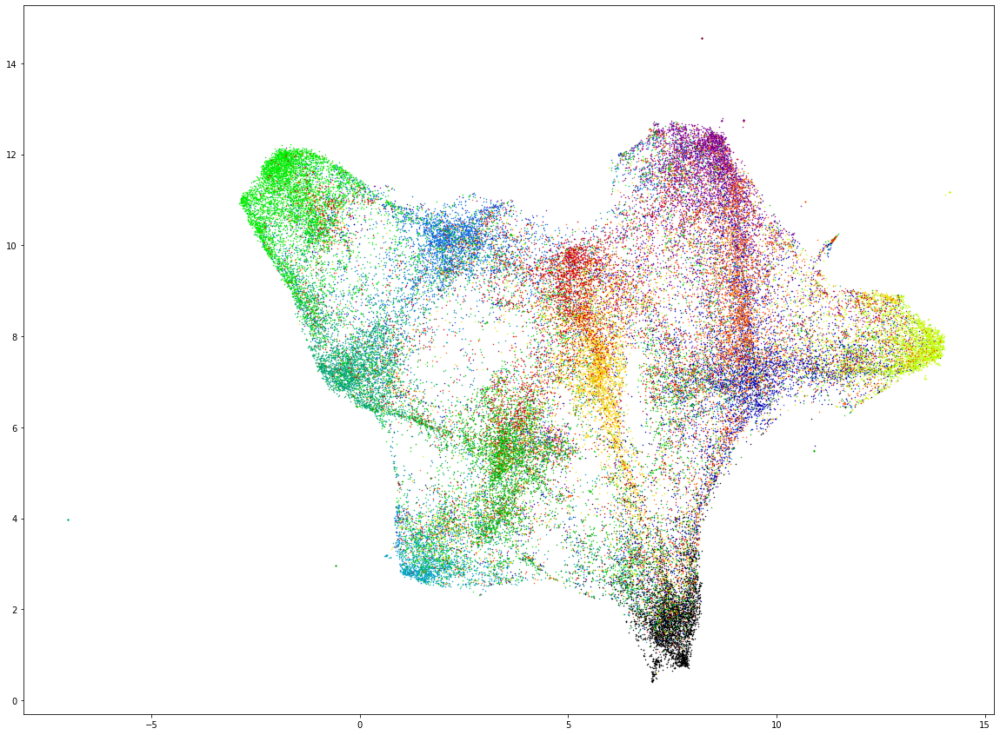

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.33102691836678244
INFO:PML:TRAINING EPOCH 10
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.45344: 100%|██████████| 1860/1860 [09:28<00:00,  3.27it/s]
INFO:PML:Evaluating epoch 10
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [05:14<00:00,  6.02it/s]
INFO:PML:R

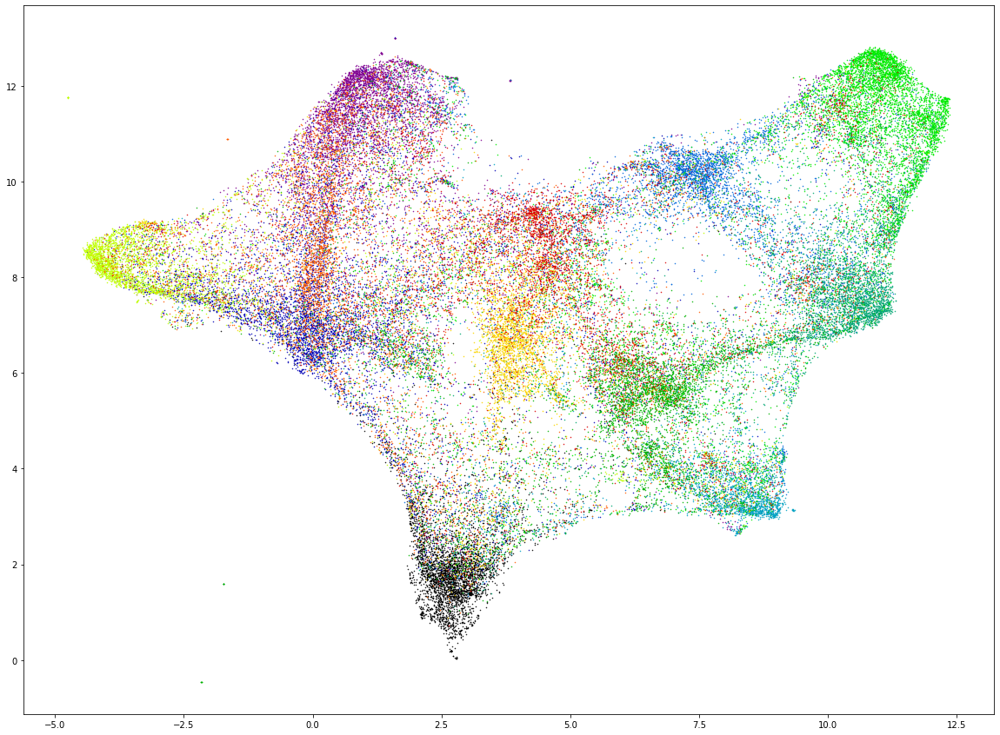

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.34160368280052916
INFO:PML:TRAINING EPOCH 11
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.92830: 100%|██████████| 1860/1860 [09:37<00:00,  3.22it/s]
INFO:PML:Evaluating epoch 11
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [05:23<00:00,  5.85it/s]
INFO:PML:R

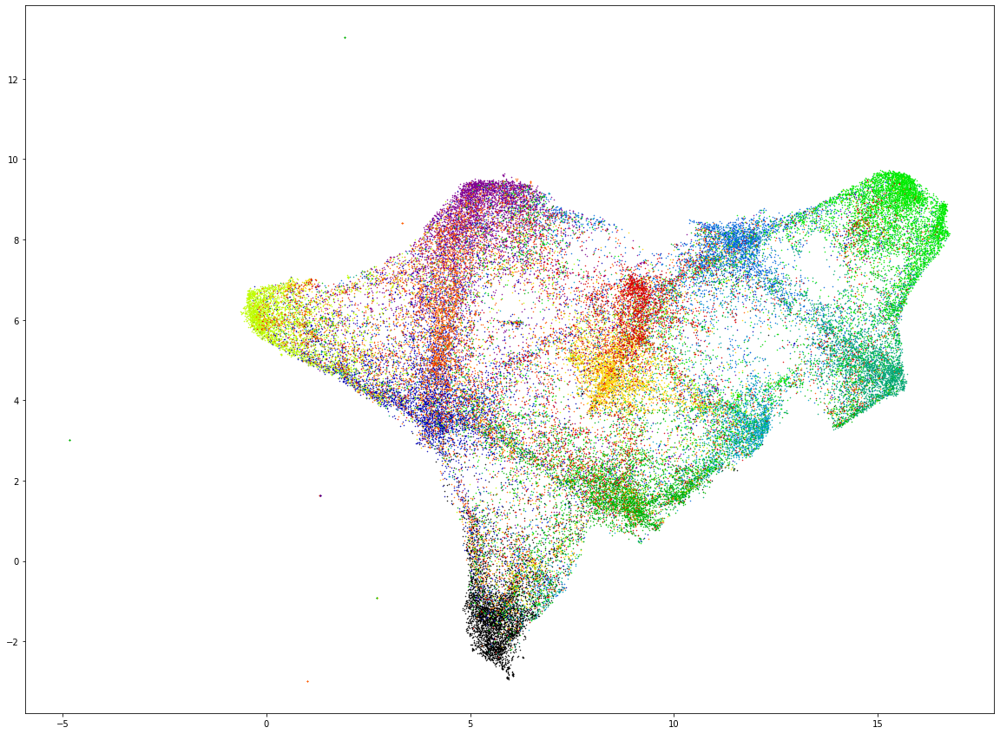

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3498997128214299
INFO:PML:TRAINING EPOCH 12
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.50387: 100%|██████████| 1860/1860 [10:11<00:00,  3.04it/s]
INFO:PML:Evaluating epoch 12
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [05:35<00:00,  5.64it/s]
INFO:PML:Ru

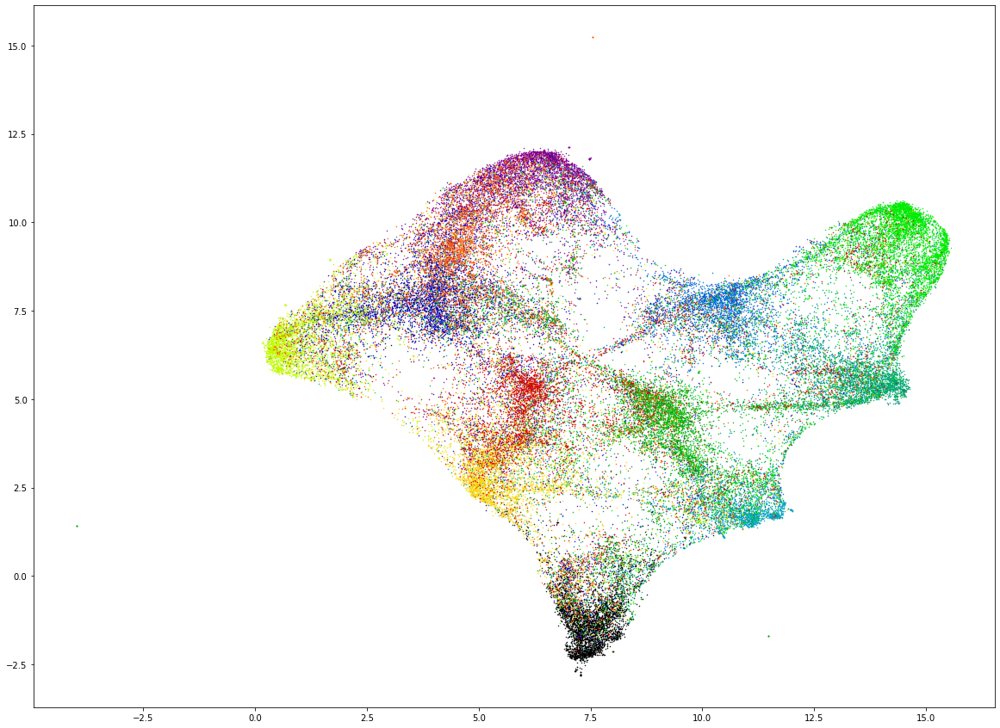

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3605324406859792
INFO:PML:TRAINING EPOCH 13
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=10.30110: 100%|██████████| 1860/1860 [10:34<00:00,  2.93it/s]
INFO:PML:Evaluating epoch 13
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [05:49<00:00,  5.42it/s]
INFO:PML:R

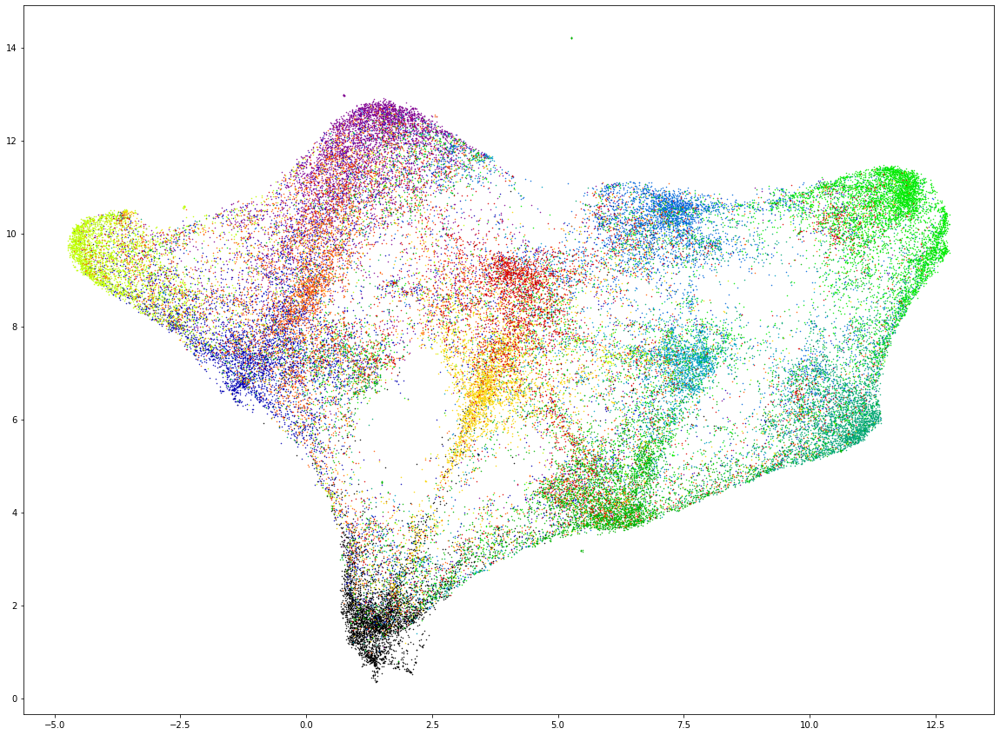

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3662572957638424
INFO:PML:TRAINING EPOCH 14
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=7.82288: 100%|██████████| 1860/1860 [11:01<00:00,  2.81it/s]
INFO:PML:Evaluating epoch 14
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [06:02<00:00,  5.21it/s]
INFO:PML:Ru

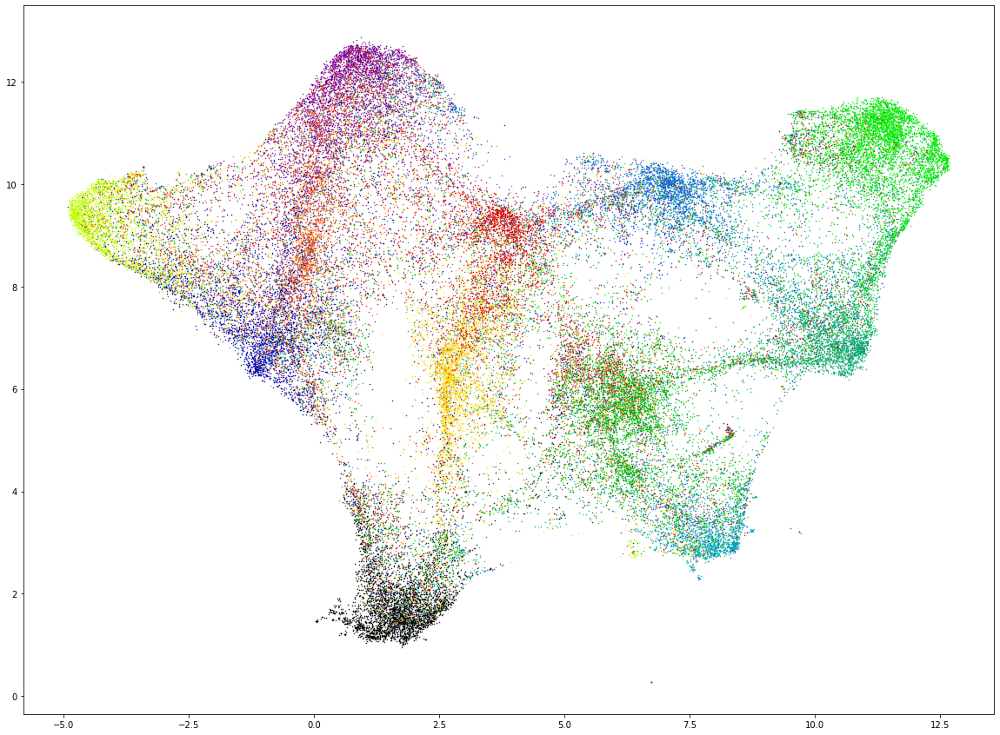

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.36957220036480465
INFO:PML:TRAINING EPOCH 15
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.87040: 100%|██████████| 1860/1860 [11:09<00:00,  2.78it/s]
INFO:PML:Evaluating epoch 15
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [06:03<00:00,  5.20it/s]
INFO:PML:R

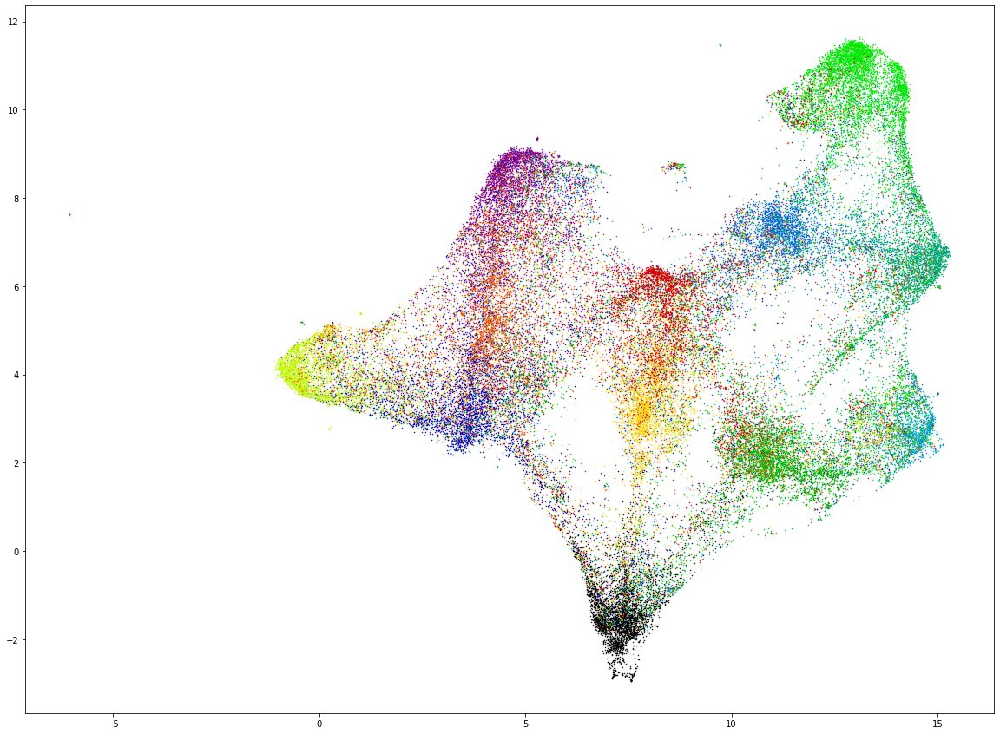

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.37624762454595406
INFO:PML:TRAINING EPOCH 16
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=7.72018: 100%|██████████| 1860/1860 [11:20<00:00,  2.73it/s]
INFO:PML:Evaluating epoch 16
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [06:14<00:00,  5.06it/s]
INFO:PML:R

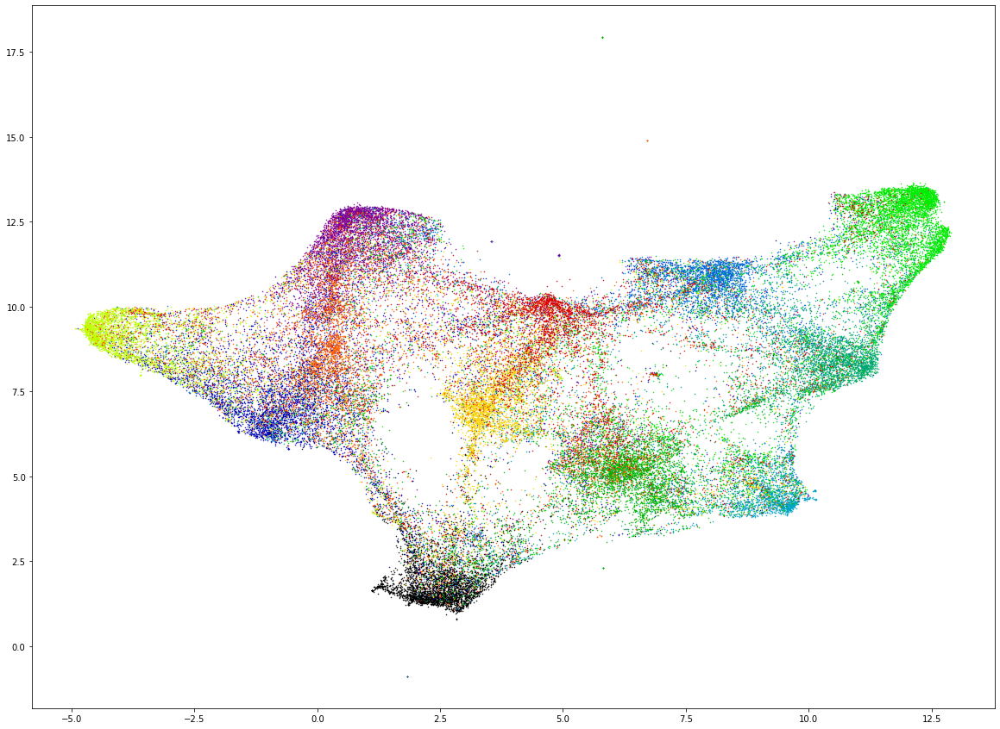

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.38544241371591753
INFO:PML:TRAINING EPOCH 17
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.83755: 100%|██████████| 1860/1860 [11:40<00:00,  2.66it/s]
INFO:PML:Evaluating epoch 17
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [06:23<00:00,  4.93it/s]
INFO:PML:R

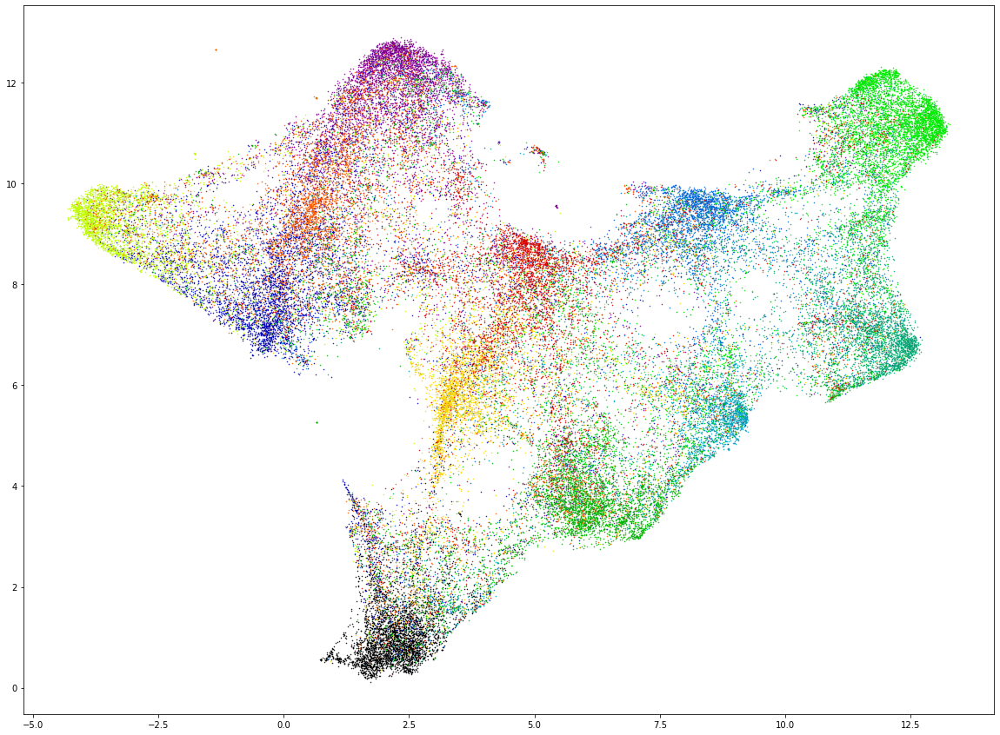

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.38622315945969965
INFO:PML:TRAINING EPOCH 18
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=10.66170: 100%|██████████| 1860/1860 [11:50<00:00,  2.62it/s]
INFO:PML:Evaluating epoch 18
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [06:24<00:00,  4.92it/s]
INFO:PML:

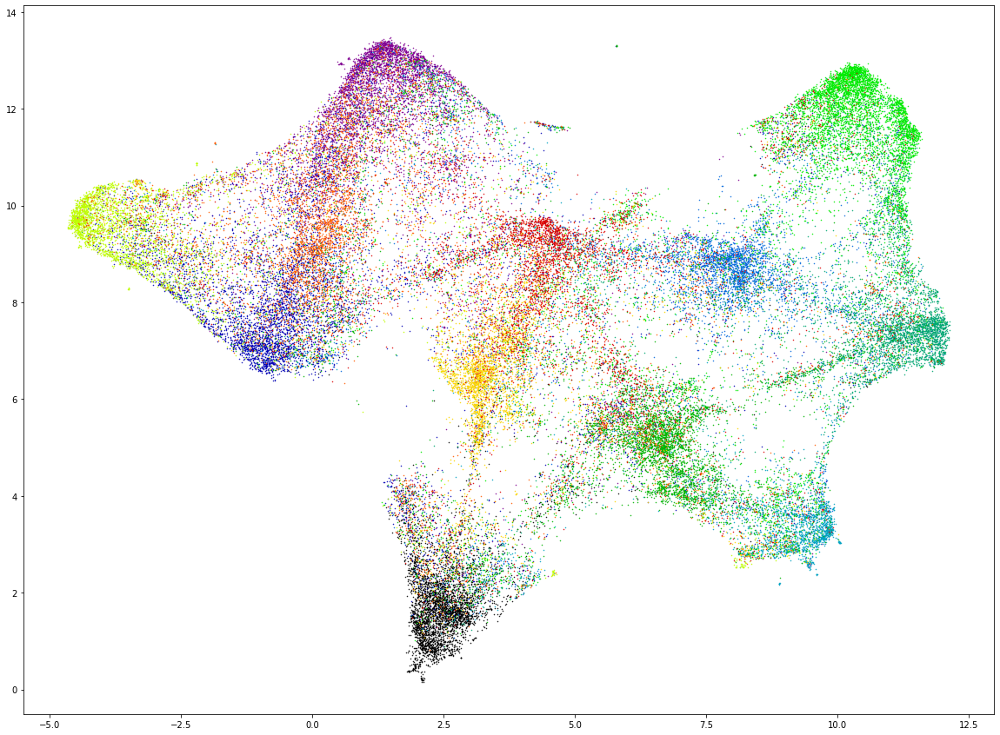

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.395568755154396
INFO:PML:TRAINING EPOCH 19
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.82326: 100%|██████████| 1860/1860 [11:47<00:00,  2.63it/s]
INFO:PML:Evaluating epoch 19
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [07:03<00:00,  4.46it/s]
INFO:PML:Run

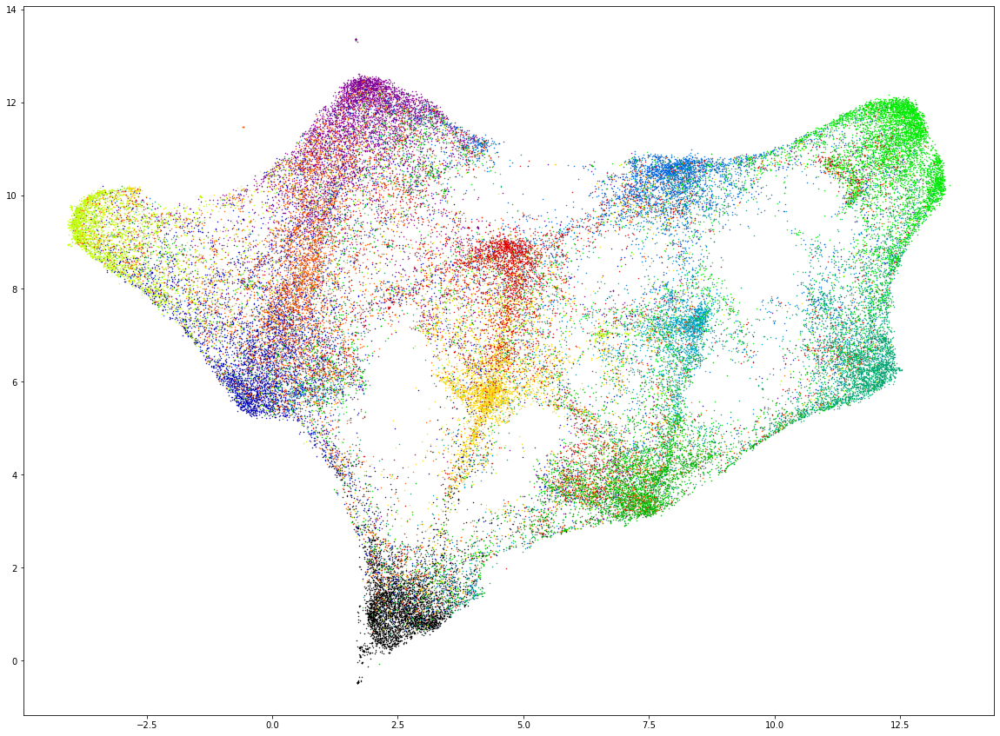

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.39680289010814457
INFO:PML:TRAINING EPOCH 20
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.38405: 100%|██████████| 1860/1860 [12:16<00:00,  2.52it/s]
INFO:PML:Evaluating epoch 20
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [07:15<00:00,  4.34it/s]
INFO:PML:R

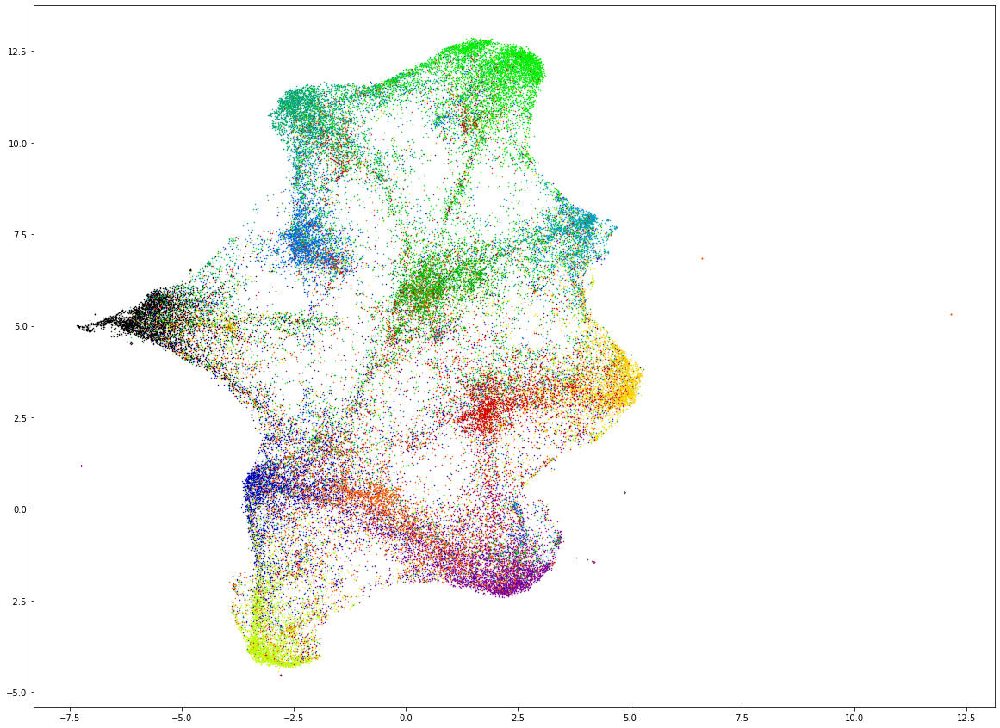

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.39894338356752107
INFO:PML:TRAINING EPOCH 21
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.59040: 100%|██████████| 1860/1860 [12:17<00:00,  2.52it/s]
INFO:PML:Evaluating epoch 21
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [07:39<00:00,  4.11it/s]
INFO:PML:R

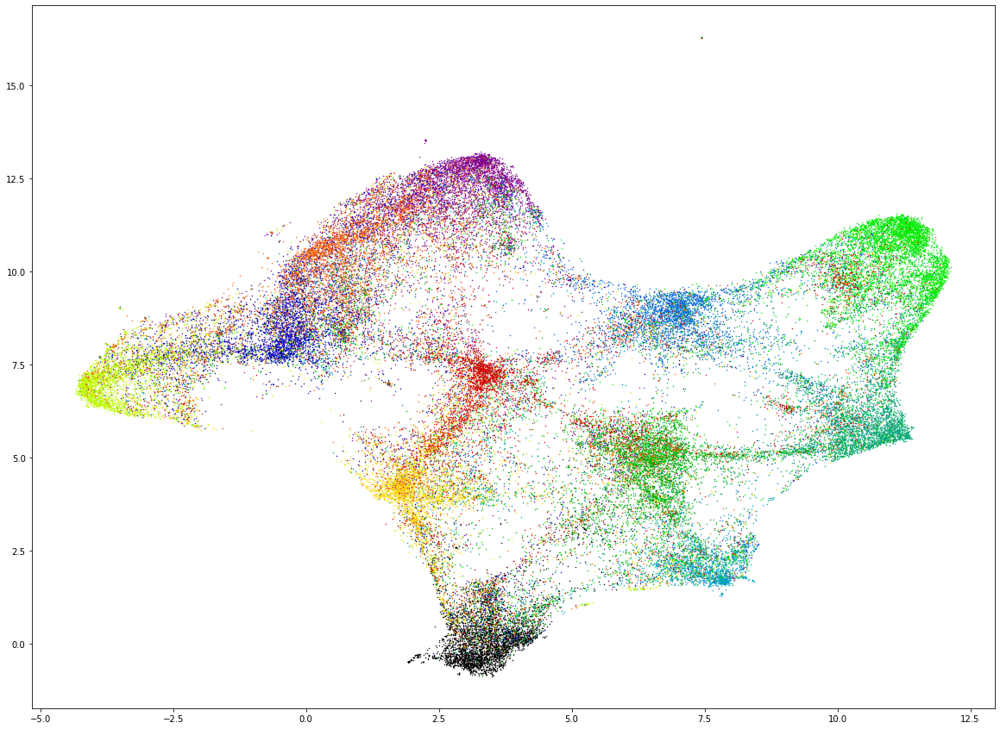

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.4045690277445819
INFO:PML:TRAINING EPOCH 22
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.45403: 100%|██████████| 1860/1860 [11:47<00:00,  2.63it/s]
INFO:PML:Evaluating epoch 22
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [08:06<00:00,  3.89it/s]
INFO:PML:Ru

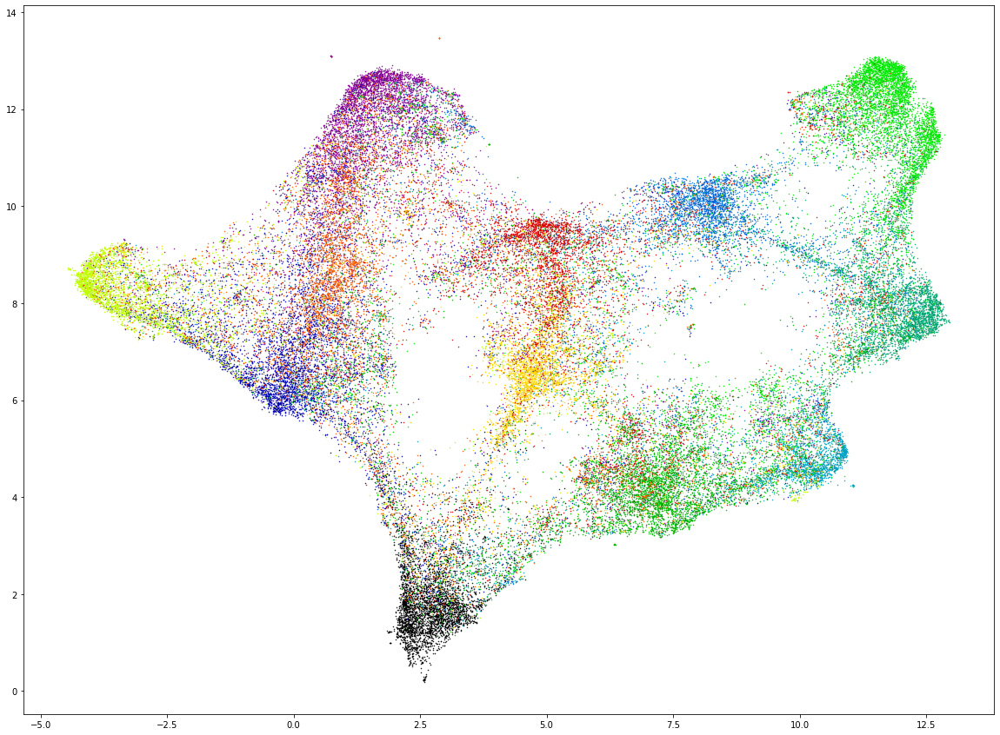

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.4057818112046914
INFO:PML:TRAINING EPOCH 23
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=7.97178: 100%|██████████| 1860/1860 [11:53<00:00,  2.61it/s]
INFO:PML:Evaluating epoch 23
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [08:07<00:00,  3.88it/s]
INFO:PML:Ru

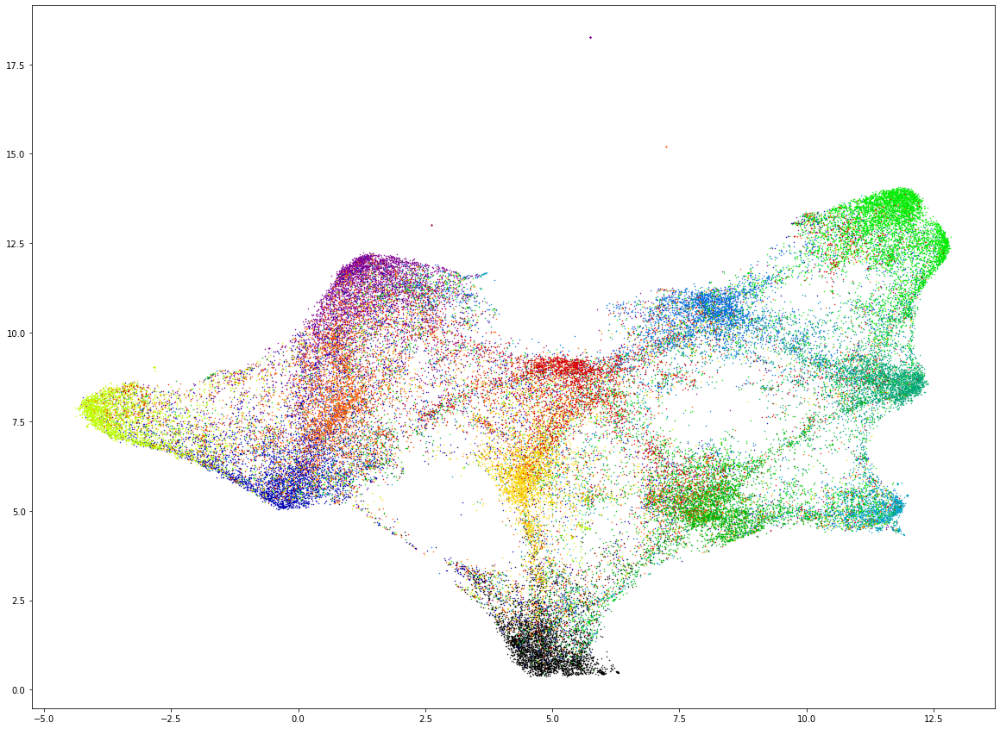

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.4139231724721911
INFO:PML:TRAINING EPOCH 24
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.86900: 100%|██████████| 1860/1860 [12:03<00:00,  2.57it/s]
INFO:PML:Evaluating epoch 24
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [08:08<00:00,  3.87it/s]
INFO:PML:Ru

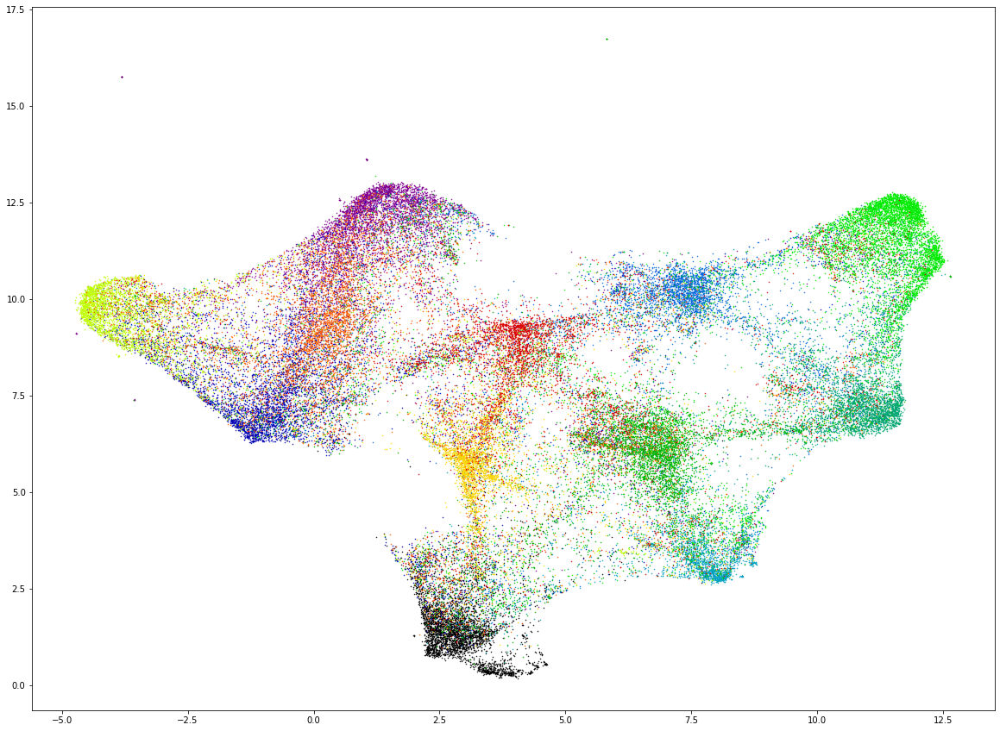

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:TRAINING EPOCH 25
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=6.39098: 100%|██████████| 1860/1860 [12:03<00:00,  2.57it/s]
INFO:PML:Evaluating epoch 25
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [08:03<00:00,  3.91it/s]
INFO:PML:Running UMAP on the val set
INFO:PML:Finished UMA

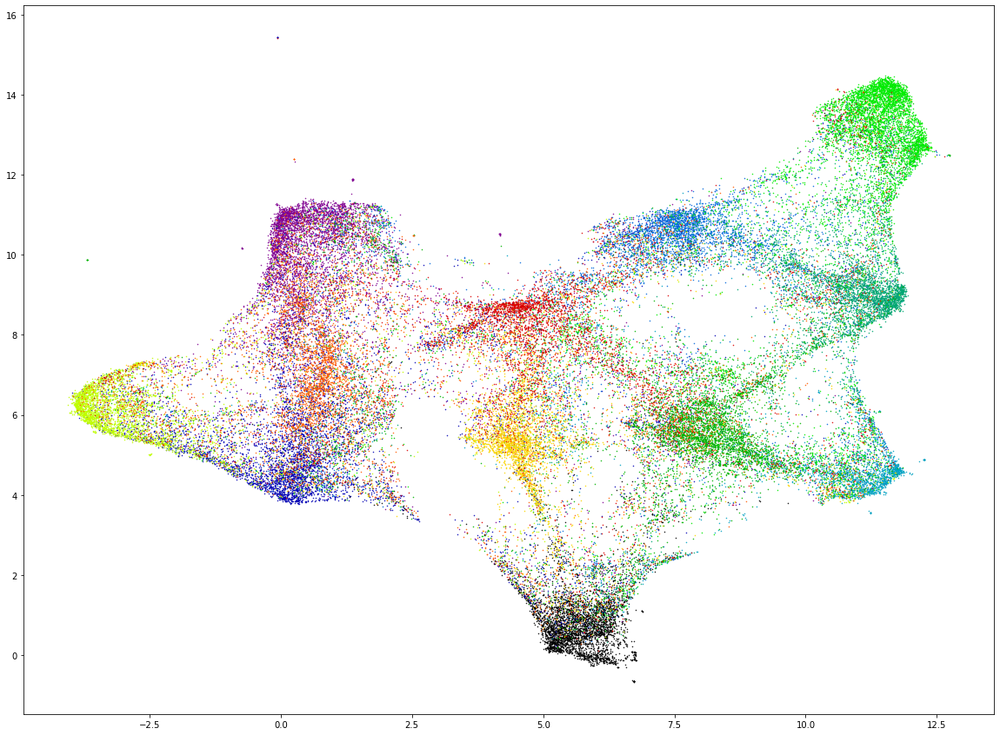

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.4205726590007243
INFO:PML:TRAINING EPOCH 26
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.23867: 100%|██████████| 1860/1860 [12:33<00:00,  2.47it/s]
INFO:PML:Evaluating epoch 26
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [08:22<00:00,  3.76it/s]
INFO:PML:Ru

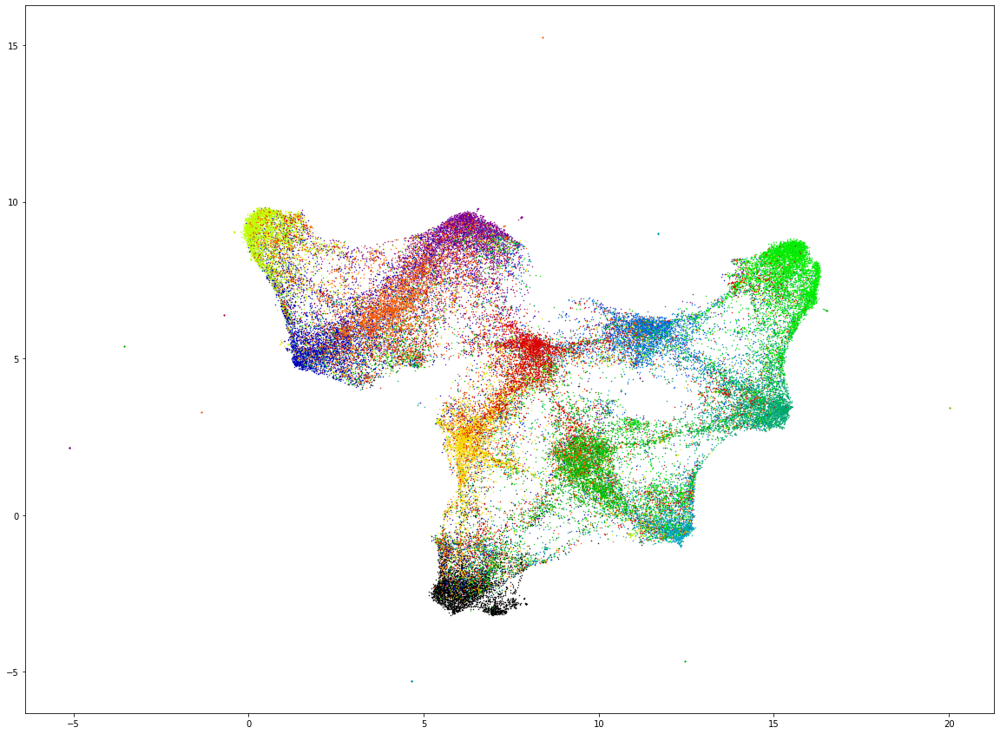

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:TRAINING EPOCH 27
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=11.29420:  48%|████▊     | 886/1860 [06:18<06:10,  2.63it/s]

In [ ]:
trainer.train(num_epochs=num_epochs)

In [ ]:
!zip -r '/content/example_logs_40.zip' example_logs
!zip -r '/content/example_saved_models_40.zip' example_saved_models
!zip -r '/content/example_tensorboard_40.zip' example_tensorboard 

!cp '/content/example_logs_40.zip' /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss
!cp '/content/example_saved_models_40.zip' /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss
!cp '/content/example_tensorboard_40.zip' /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss